# OpenStreetMap for multi-faceted Climate Risk Assessments

### Evelyn Mühlhofer, Chahan M. Kropf, David N. Bresch and Elco E. Koks

Computations for results and figures presented in the manuscript

This script is structured as follows:
  * 1. ...
  * 2. ...
  * 3. ...
  * 4. ...
  * 5. ...

In [78]:
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import shapely
import contextily as ctx
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from pathlib import Path
from datetime import datetime
import numpy as np
import pandas as pd
import geopandas as gpd
import copy

from climada.util.api_client import Client
import climada.util.lines_polys_handler as u_lp
from climada.util import coordinates as u_coord
from climada.engine.impact_calc import ImpactCalc
from climada.entity.impact_funcs import ImpactFuncSet, ImpactFunc
from climada.entity.impact_funcs.storm_europe import ImpfStormEurope
from climada.entity import Exposures
from climada.entity import LitPop
from climada import CONFIG

from climada_petals.entity.exposures.openstreetmap.osm_dataloader import OSMRaw, OSMFileQuery
from climada_petals.entity.exposures.openstreetmap.osm_dataloader import DICT_CIS_OSM

states, cntry_shape = u_coord.get_admin1_info(['CHE'])
shp_che = shapely.ops.unary_union(cntry_shape['CHE'])
gdf_che = gpd.GeoDataFrame({'geometry':[shp_che]})

## 1. Prepare OSM data 

### Getting OSM Files

In [2]:
# download osm.pbf file for Switzerland from geofabrik
DATA_DIR = CONFIG.exposures.openstreetmap.local_data.dir()
OSMRaw().get_data_geofabrik('CHE', file_format='pbf', save_path=DATA_DIR)

In [3]:
# Initiate a OSMFileQuery instance with path to the downloaded file
SwissFileQuery = OSMFileQuery(Path(DATA_DIR,'switzerland-latest.osm.pbf'))

### Extracting geo-data from OSM files

Creating some util functions for pre-processing: duplicate entry removal

In [4]:
def _find_duplicates(overlap_gdf):
    indices_dupl = np.unique([index_right for index_right, index_left in zip(overlap_gdf.index_right, overlap_gdf.index_left)
                    if index_right != index_left])
    indices_dupl = indices_dupl[:int(len(indices_dupl/2))] # only first half of duplicates should be removed!
    return indices_dupl

def _remove_duplicates(orig_gdf, indices_dupl):
    indices_keep = list(set(orig_gdf.index).difference(set(indices_dupl)))
    return orig_gdf.loc[indices_keep]

def find_remove_duplicates(orig_gdf):
    if 'index' in orig_gdf.columns:
        orig_gdf = orig_gdf.drop('index', axis=1)
    overlap_gdf = orig_gdf.sjoin(orig_gdf)
    if 'index_left' not in overlap_gdf.columns:
        overlap_gdf = overlap_gdf.reset_index()
        overlap_gdf = overlap_gdf.rename({'index':'index_left'}, axis=1)  
    indices_dupl = _find_duplicates(overlap_gdf)
    return _remove_duplicates(orig_gdf, indices_dupl)   

In [5]:
# Initiate a OSMFileQuery instance with path to the downloaded file
SwissFileQuery = OSMFileQuery(Path(DATA_DIR,'switzerland-latest.osm.pbf'))

**Healthcare infrastructure**

In [6]:
gdf_health = SwissFileQuery.retrieve_cis('healthcare')

extract multipolygons: 100%|██████████████████████████████████████████████████████████████████| 1403/1403 [00:59<00:00, 23.53it/s]
/Users/ckropf/Documents/Climada/climada_petals/climada_petals/entity/exposures/openstreetmap/osm_dataloader.py:561: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(


In [7]:
# make a buffer around point-results to check for intersecting duplicates using above util funcs
gdf_health = gdf_health.reset_index(drop=True)
gdf_health_pnt = gdf_health[gdf_health.geometry.type=='Point']
gdf_health_pnt['geometry'] = gdf_health_pnt.geometry.buffer(0.001) # ca. 100m buffer
gdf_health_poly = gdf_health[gdf_health.geometry.type=='MultiPolygon']

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_1482/855197716.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_health_pnt['geometry'] = gdf_health_pnt.geometry.buffer(0.001) # ca. 100m buffer


In [8]:
gdf_health_pnt = find_remove_duplicates(gdf_health_pnt)
gdf_health_poly = find_remove_duplicates(gdf_health_poly)
gdf_health = pd.concat([gdf_health_pnt, gdf_health_poly])
gdf_health = find_remove_duplicates(gdf_health)
gdf_health['geometry'] = gdf_health.geometry.centroid

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_1482/1628341272.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_health['geometry'] = gdf_health.geometry.centroid


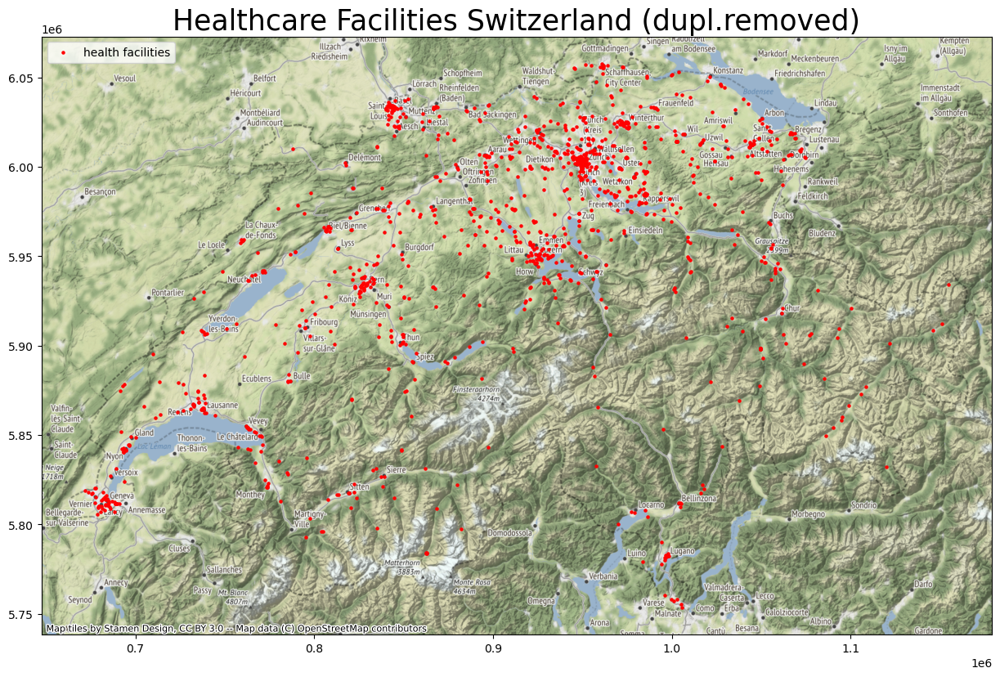

In [9]:
# Checkplot for results
ax = gdf_health.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(15, 15), alpha=1, markersize=5, color='red', 
                    edgecolor='red', label='health facilities')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Healthcare Facilities Switzerland (dupl.removed)', fontsize=25)
ctx.add_basemap(ax)
plt.show()

**Airports**

In [9]:
gdf_airports_orig = SwissFileQuery.retrieve_cis('air')

extract multipolygons: 100%|██████████████████████████████████████████████████████████████████████| 44/44 [00:38<00:00,  1.14it/s]


In [10]:
# pre-processing: duplicate entry removal
gdf_airports = copy.deepcopy(gdf_airports_orig.reset_index(drop=True))
gdf_airports_pnt = gdf_airports[gdf_airports.geometry.type=='Point']
gdf_airports_pnt['geometry'] = gdf_airports_pnt.geometry.buffer(0.001) # ca. 100m buffer
gdf_airports_poly = gdf_airports[gdf_airports.geometry.type=='MultiPolygon']

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_1482/4117507995.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_airports_pnt['geometry'] = gdf_airports_pnt.geometry.buffer(0.001) # ca. 100m buffer


In [11]:
gdf_airports_poly = find_remove_duplicates(gdf_airports_poly)
gdf_airports_pnt = find_remove_duplicates(gdf_airports_pnt)
gdf_airports = pd.concat([gdf_airports_pnt, gdf_airports_poly])
gdf_airports = find_remove_duplicates(gdf_airports)
gdf_airports['geometry'] = gdf_airports.geometry.centroid

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_1482/1067562824.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_airports['geometry'] = gdf_airports.geometry.centroid


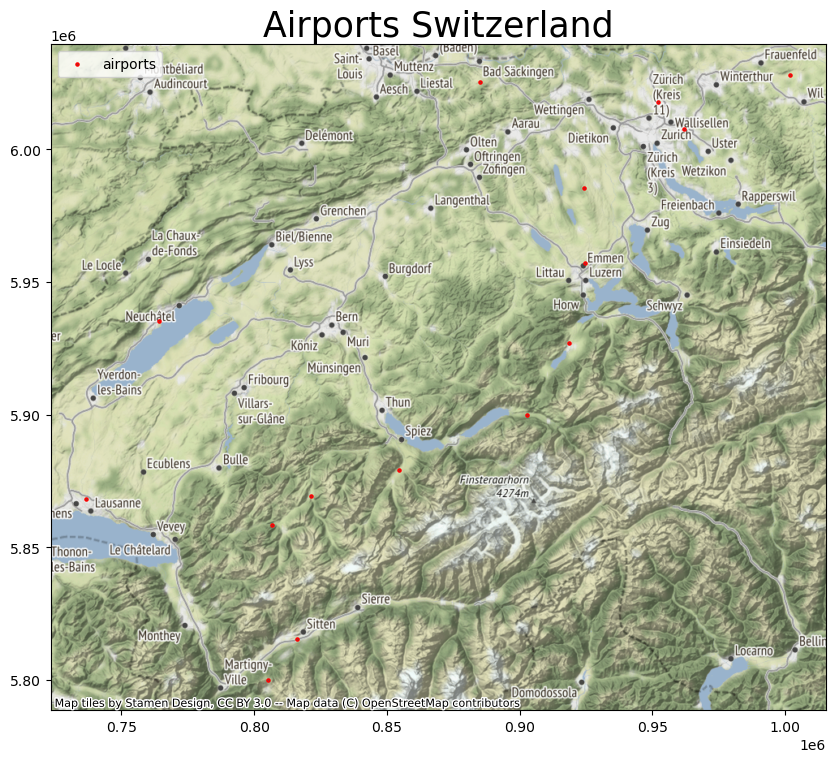

In [14]:
# Check-plot for results
ax = gdf_airports.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(10, 10), alpha=1, markersize=5, color='brown', 
                    edgecolor='red', label='airports')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Airports Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

**Railways**

In [12]:
# no convencience wrapper for railways --> specify osm tags
osm_keys=['railway', 'name']
osm_query="railway='rail' or railway='tram' or railway='light_rail' or railway='narrow_gauge'"

gdf_rails = SwissFileQuery.retrieve('lines', osm_keys, osm_query)

extract lines: 100%|██████████████████████████████████████████████████████████████████████| 50514/50514 [00:16<00:00, 3004.77it/s]


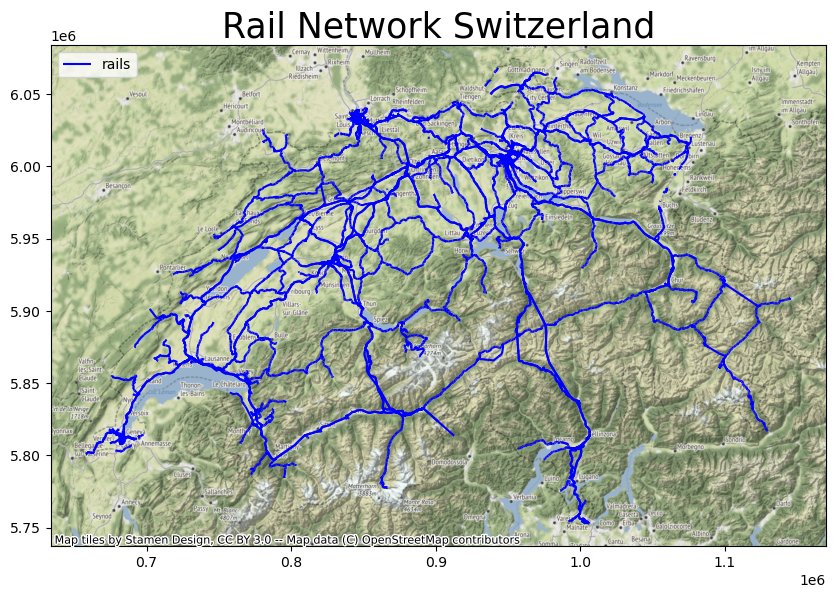

In [16]:
# Check-plot of results
ax = gdf_rails.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(10, 10), alpha=1, markersize=5, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Rail Network Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

**Forests**

In [13]:
# Forests in Switzerland
osm_keys = ['landuse']
osm_query = "landuse='forest'"
gdf_forest = SwissFileQuery.retrieve('multipolygons', osm_keys, osm_query)

extract multipolygons: 100%|██████████████████████████████████████████████████████████████| 76090/76090 [00:45<00:00, 1666.12it/s]


In [14]:
# do some cleaning: only valid shapes, not very tiny ones
import shapely
def make_valid(geometry):
    if geometry.is_valid:
        return geometry
    return geometry.buffer(0.0001)

In [15]:
gdf_forest['geometry'] = gdf_forest.apply(lambda row: make_valid(row.geometry), axis=1)
gdf_forest = gdf_forest[gdf_forest['geometry'].area > 1e-5]

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1784: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number o

/var/folders/jm/4przql117d9gb9g4hb45fd4c0000gp/T/ipykernel_11619/3488119659.py:4: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  handles, labels = ax.get_legend_handles_labels()


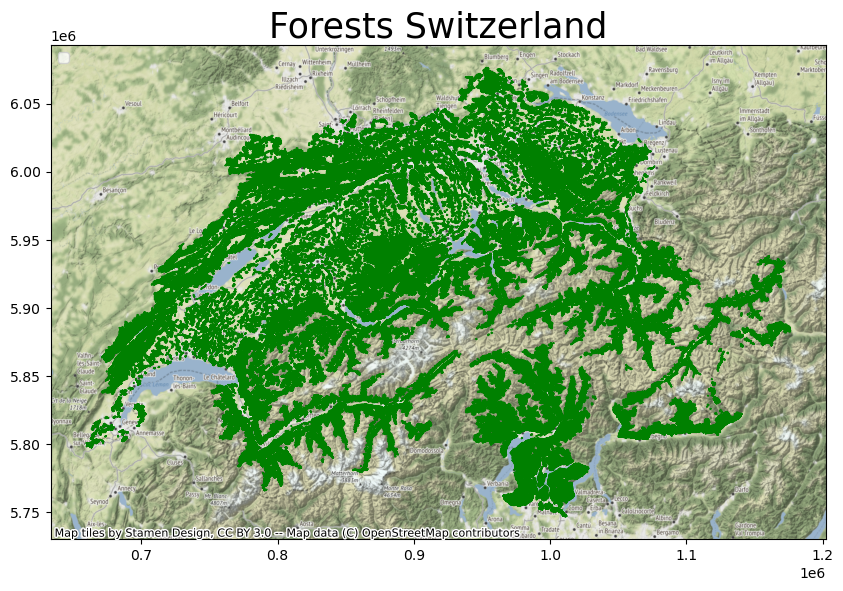

In [24]:
# Check plot results
ax = gdf_forest.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(10, 10), alpha=1, markersize=5, color='green', 
                    edgecolor='green', label='forest')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Forests Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

**UNESCO Cultural Heritage Sites**

In [16]:
# no convenience wrapper for UNESCO sites --> use OSM tag structure
unesco_query = {
    'osm_keys': ['heritage_operator', 'name', 'heritage'],
    'osm_query': "heritage_operator='whc'"
}

In [17]:
gdf_list = []
for shape in ['points', 'lines', 'multipolygons']:
    try:
        gdf = SwissFileQuery.retrieve(shape, unesco_query['osm_keys'], unesco_query['osm_query'])
        gdf_list.append(gdf)
    except TypeError:
        print(f'{shape} not found')
gdf_unesco = pd.concat(gdf_list)


extract points: 100%|███████████████████████████████████████████████████████████████████████████████| 8/8 [00:06<00:00,  1.24it/s]
extract lines: 0it [00:10, ?it/s]
extract multipolygons: 100%|████████████████████████████████████████████████████████████████████████| 3/3 [00:50<00:00, 16.86s/it]


/var/folders/jm/4przql117d9gb9g4hb45fd4c0000gp/T/ipykernel_11619/761359287.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_unesco_plot.geometry = gdf_unesco_plot.geometry.centroid


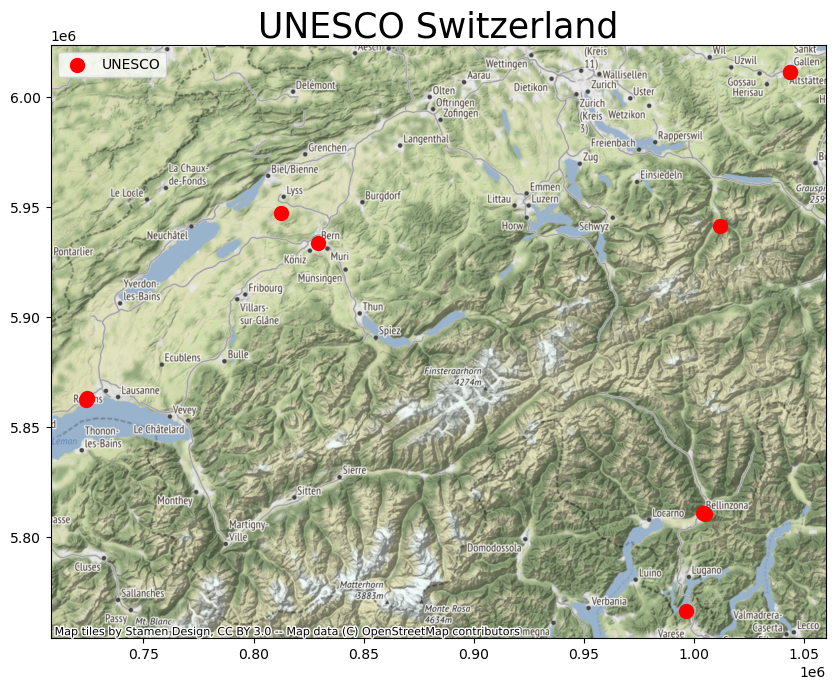

In [23]:
# Check plot for results
gdf_unesco_plot = gdf_unesco.copy()
gdf_unesco_plot.geometry = gdf_unesco_plot.geometry.centroid
ax = gdf_unesco_plot.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(10, 10), alpha=1, markersize=100, color='red', 
                    edgecolor='red', label='UNESCO')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('UNESCO Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

## 2. Loading Hazard Data

In [18]:
# Let's take european winter storms in Switzerland, from CLIMADA Data API
client = Client()
ws_che = client.get_hazard('storm_europe', properties={'country_name': 'Switzerland'})
print(f'Start-date historic records: {datetime.fromordinal(int(np.min(ws_che.date)))}')
print(f'End-date historic records: {datetime.fromordinal(int(np.max(ws_che.date)))}')

Start-date historic records: 1940-11-01 00:00:00
End-date historic records: 2013-12-05 00:00:00


**Lothar**

In [19]:
# Lothar happened around Dec 26, 1999 --> filter this timespan
date_lothar_start = datetime(1999, 12, 25)
date_lothar_end = datetime(1999, 12, 31)
date_lothar_start_ordinal = date_lothar_start.toordinal()
date_lothar_end_ordinal = date_lothar_end.toordinal()
ws_lothar = ws_che.select(orig=True, date=[date_lothar_start_ordinal, date_lothar_end_ordinal])
# ugly work-around for making eai_exp plot an at_event plot later --> frequency = 1
ws_lothar.frequency = np.array([1])

<GeoAxes: title={'center': 'WS max intensity at each point'}>

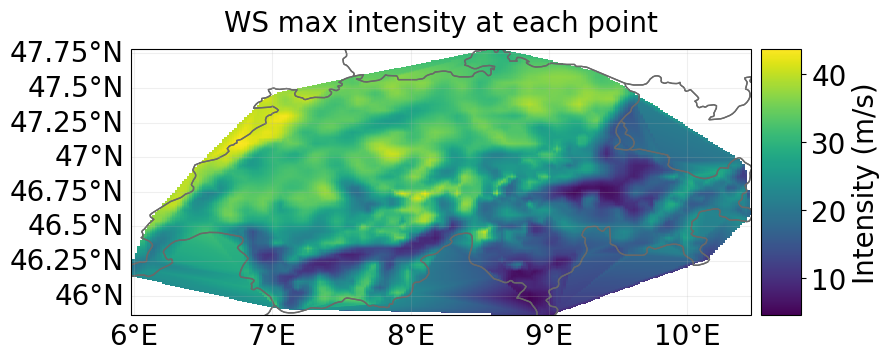

In [27]:
# Checkplot of Winter Storm Lothar
ws_lothar.plot_intensity(0)

**Vivian**

In [39]:
# Vivian happened around Feb 27, 1990
date_vivian_start = datetime(1990, 2, 26)
date_vivian_end = datetime(1990, 2, 28)

date_vivian_start_ordinal = date_vivian_start.toordinal()
date_vivian_end_ordinal = date_vivian_end.toordinal()
ws_vivian = ws_che.select(orig=True, date=[date_vivian_start_ordinal, date_vivian_end_ordinal])
# ugly work-around for making eai_exp plot an at_event plot later --> frequency = 1
ws_vivian.frequency = np.array([1])

<GeoAxesSubplot:title={'center':'WS max intensity at each point'}>

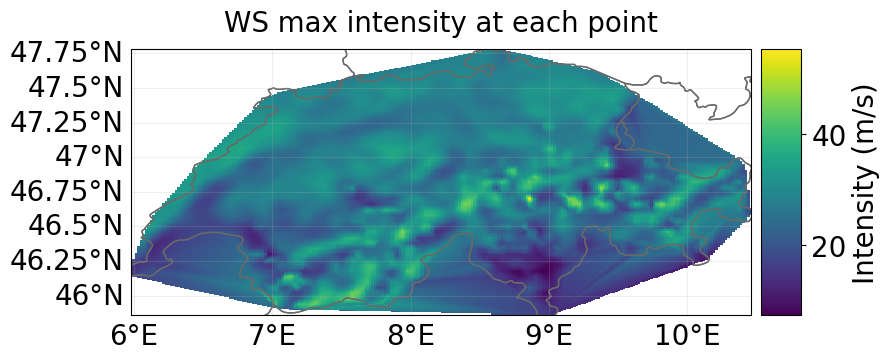

In [40]:
ws_vivian.plot_intensity(0)

**A few random probabilistic ones (for figure plotting only)**

<GeoAxesSubplot:title={'center':'Event ID 15229: 15229'}>

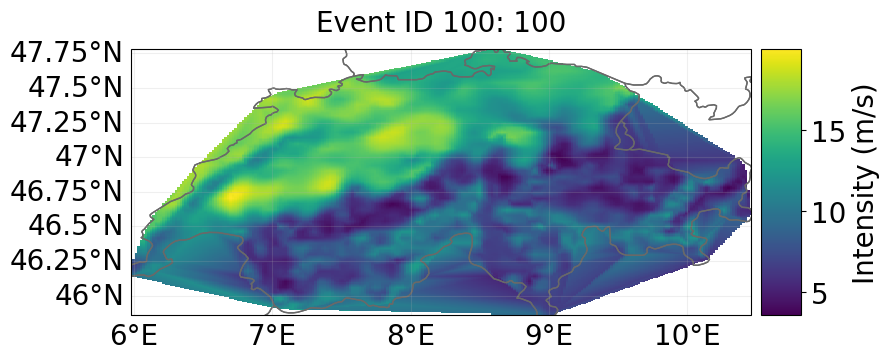

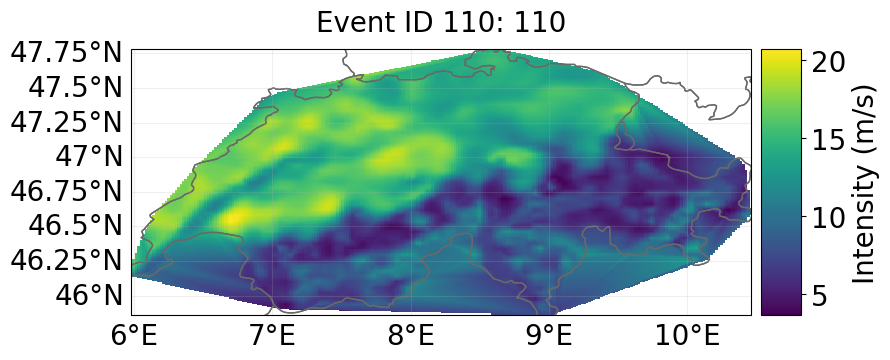

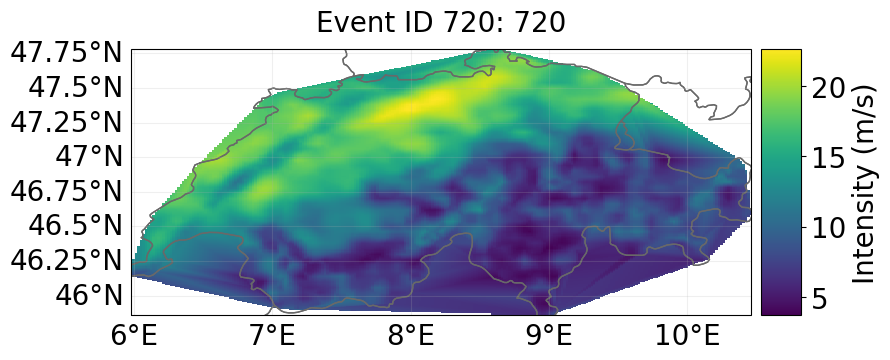

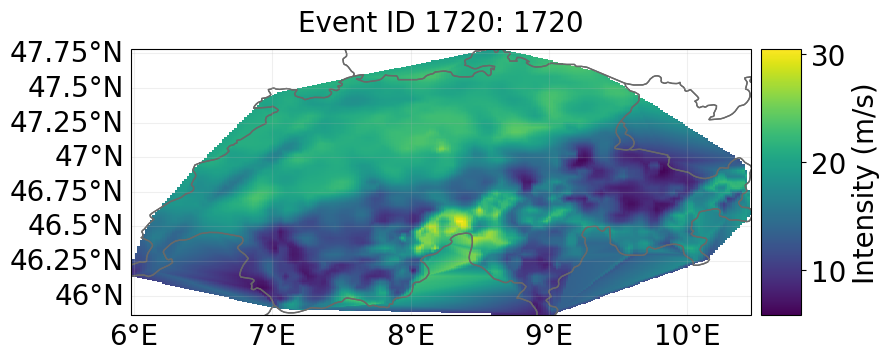

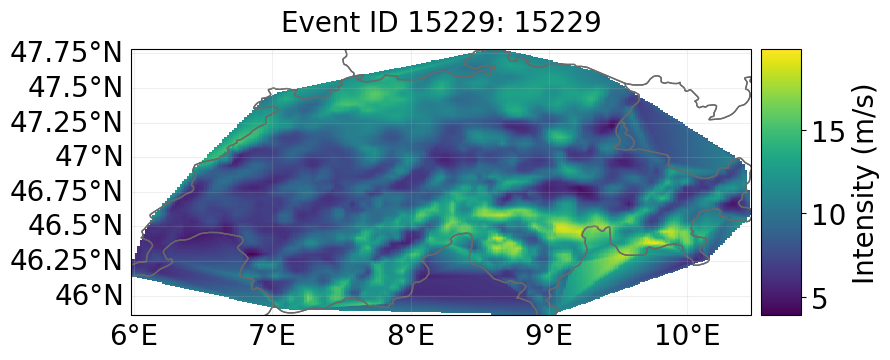

In [38]:
ws_che.plot_intensity(event=ws_che.event_id[0])
ws_che.plot_intensity(event=ws_che.event_id[10])
ws_che.plot_intensity(event=ws_che.event_id[200])
ws_che.plot_intensity(event=ws_che.event_id[500])
ws_che.plot_intensity(event=ws_che.event_id[-1])

## 3. Defining impact functions

In [19]:
impf_set = ImpactFuncSet()

In [20]:
# Welker (2021) Function
impf_welker = ImpfStormEurope.from_welker()
impf_welker.name = 'Asset damages \n Welker et al. (2021)'
impf_set.append(impf_welker)
impf_set.check()

In [21]:
# start of warning level 4 MCH
impf_thresh = ImpactFunc.from_step_impf([0,30.5,150],impf_id=2, haz_type = 'WS') 
impf_thresh.intensity_unit = 'm/s'
impf_thresh.name = 'Storm warning \n cat. 4'
impf_set.append(impf_thresh)
impf_set.check()

In [22]:
# Start of warning level 5 MCH
impf_W5 = ImpactFunc.from_step_impf([0,38.9,150], impf_id=4, haz_type = 'WS') # tree blowdown fund
impf_W5.intensity_unit = 'm/s'
impf_W5.name = 'Storm warning \n cat. 5'
impf_set.append(impf_W5)
impf_set.check()

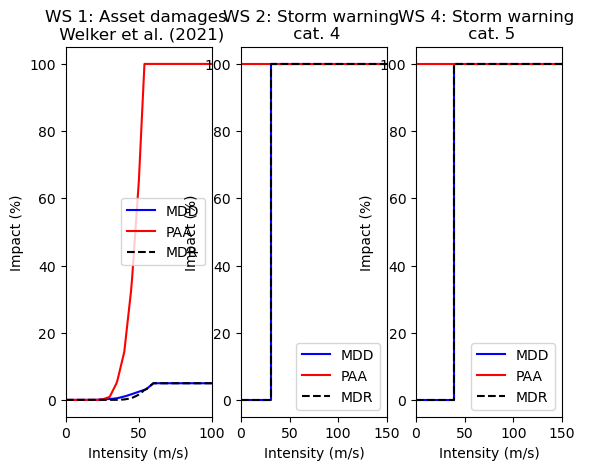

In [40]:
# Check-plot
impf_set.plot();

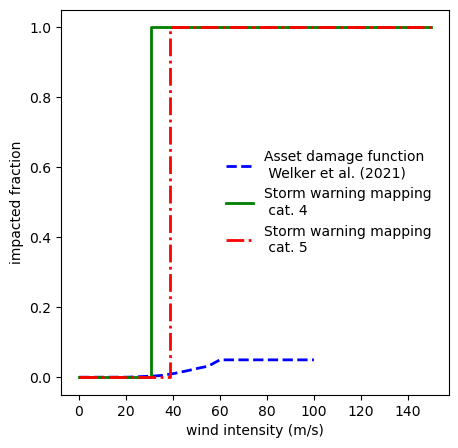

In [41]:
# All-in one nice plot for paper
fig, ax = plt.subplots(1,1, figsize=(5, 5))

lp1 = ax.plot(impf_welker.intensity, impf_welker.mdd, 'b--', linewidth=2, label='Asset damage function \n Welker et al. (2021)');
ax.plot(impf_thresh.intensity, impf_thresh.mdd, 'g-', linewidth=2, label='Storm warning mapping \n cat. 4');
ax.plot(impf_W5.intensity, impf_W5.mdd, 'r-.', linewidth=2, label='Storm warning mapping \n cat. 5');
ax.set_xlabel('wind intensity (m/s)');
ax.set_ylabel('impacted fraction');
ax.legend(loc='center right', frameon=False);

#plt.savefig('./imp_funcs_all1.png', 
#                    format='png', dpi=100,
#        bbox_inches=None, pad_inches=0.1,
#        facecolor='auto', edgecolor='auto',
#        backend=None)

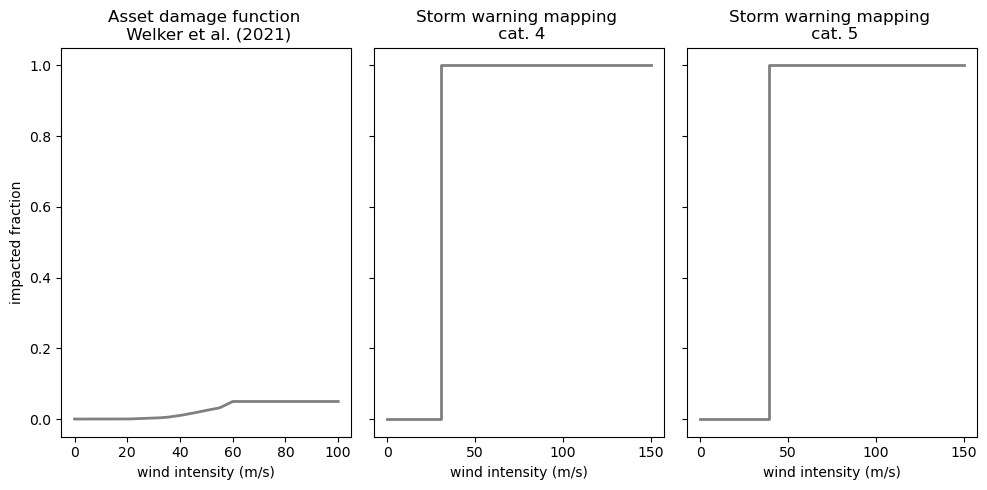

In [42]:
# Another version of same content
fig, axes = plt.subplots(1,3, figsize=(10, 5), sharey='row')

axes = axes.flatten()
lp1 = axes[0].plot(impf_welker.intensity, impf_welker.mdd, 'gray', linewidth=2)
axes[0].set_xlabel('wind intensity (m/s)')
axes[0].set_ylabel('impacted fraction')
axes[0].set_title('Asset damage function \n Welker et al. (2021)')

lp2 = axes[1].plot(impf_thresh.intensity, impf_thresh.mdd, 'gray', linewidth=2)
axes[1].set_xlabel('wind intensity (m/s)')
axes[1].set_title('Storm warning mapping \n cat. 4')

lp3 = axes[2].plot(impf_W5.intensity, impf_W5.mdd, 'gray', linewidth=2)
axes[2].set_xlabel('wind intensity (m/s)')
axes[2].set_title('Storm warning mapping \n cat. 5')

fig.tight_layout()
#plt.savefig('./imp_funcs.png', 
#                   format='png', dpi=100,
#        bbox_inches=None, pad_inches=0.1,
#        facecolor='auto', edgecolor='auto',
#        backend=None)

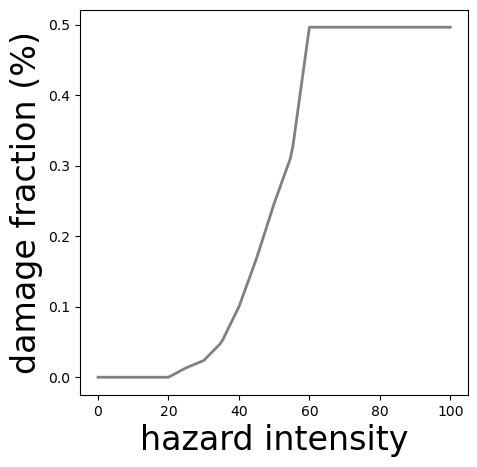

In [32]:
# "random" df for schematic plot
fig, axes = plt.subplots(1,1, figsize=(5, 5), sharey='row')
lp1 = axes.plot(impf_welker.intensity, impf_welker.mdd*10, 'gray', linewidth=2);
axes.set_xlabel('hazard intensity', fontsize=24);
axes.set_ylabel('damage fraction (%)', fontsize=24);

## 4. Exposures

**Exposures from OSM gdfs**

In [23]:
exp_health = Exposures(gdf_health)
exp_health.gdf['impf_WS'] = 2
exp_health.gdf['value'] = 1
exp_health.gdf['geometry'] = exp_health.gdf.geometry.centroid # simplify to points
exp_health.value_unit = 'units'
exp_health.set_lat_lon()
exp_health.check()

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_1482/3207582622.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  exp_health.gdf['geometry'] = exp_health.gdf.geometry.centroid # simplify to points


In [24]:
exp_airports = Exposures(gdf_airports)
exp_airports.gdf['impf_WS'] = 2
exp_airports.gdf['value'] = 1
exp_airports.value_unit = 'units'
exp_airports.set_lat_lon()
exp_airports.check()

In [25]:
# Making exposures with non-point geometry data:
exp_rails = Exposures(gdf_rails)
exp_rails.gdf['impf_WS'] = 2

In [26]:
gdf_forest_42 = copy.deepcopy(gdf_forest)
exp_forest_42 = Exposures(gdf_forest_42)
exp_forest_42.gdf['impf_WS'] = 3

In [27]:
gdf_forest_W4 = copy.deepcopy(gdf_forest)
exp_forest_W4 = Exposures(gdf_forest_W4)
exp_forest_W4.gdf['impf_WS'] = 2

In [28]:
gdf_forest_W5 = copy.deepcopy(gdf_forest)
exp_forest_W5 = Exposures(gdf_forest_W5)
exp_forest_W5.gdf['impf_WS'] = 4

In [29]:
# Making exposures with non-point geometry data:
exp_airport = Exposures(gdf_airports)
exp_airport.gdf['impf_WS'] = 2

In [30]:
# UNESCO heritage sites
exp_unesco = Exposures(gdf_unesco)
exp_unesco.gdf['impf_WS'] = 2
exp_unesco.gdf['value'] = 1
exp_unesco.gdf['geometry'] = exp_unesco.gdf.geometry.centroid # simplify to points
exp_unesco.value_unit = 'units'
exp_unesco.set_lat_lon()
exp_unesco.check()

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_1482/3370603622.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  exp_unesco.gdf['geometry'] = exp_unesco.gdf.geometry.centroid # simplify to points


**Exposures from LitPop**

In [31]:
# asset values (1,1)
exp_lp = LitPop().from_countries(['CHE'],reference_year=1999)
exp_lp.gdf['impf_WS'] = 1

In [32]:
# population gridded counts (0,1)
exp_pop = LitPop().from_countries(['CHE'], exponents=(0, 1), fin_mode='pop', reference_year=1999)
exp_pop.gdf['impf_WS'] = 2

**Exposure plots**

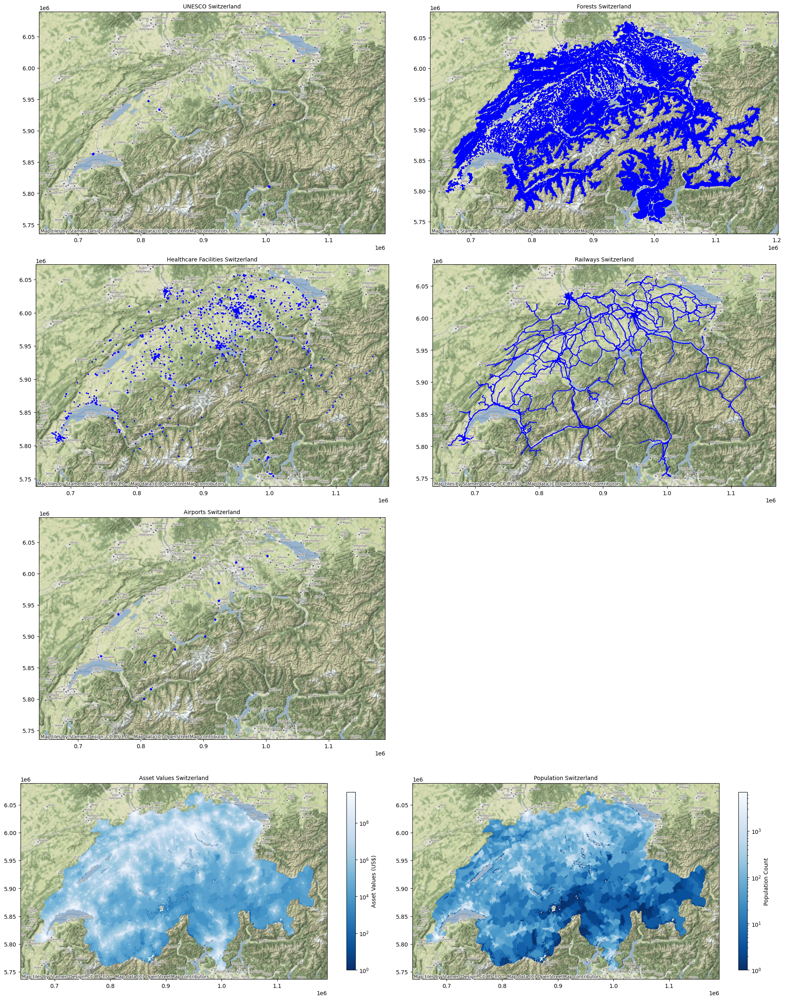

In [61]:
border = cfeature.NaturalEarthFeature('cultural', 'admin_0_countries', '50m')

fig, axes = plt.subplots(4,2, figsize=(20,25)) #subplot_kw=dict(projection=ccrs.PlateCarree())

axes = axes.flatten()

ax = gdf_unesco_plot.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[0],
    alpha=1, markersize=10, color='blue', edgecolor='blue')
gdf_che.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[0],
    alpha=0, markersize=10, color=None, edgecolor='blue')
ax.set_title('UNESCO Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_forest.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[1],
    alpha=1, color='blue', edgecolor='blue')
ax.set_title('Forests Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_health.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[2],
    alpha=1, color='blue',markersize=3, edgecolor='blue')
ax.set_title('Healthcare Facilities Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_rails.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[3],
    alpha=1, color='blue',markersize=3, edgecolor='blue')
ax.set_title('Railways Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_airports.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[4],
    alpha=1, markersize=10, color='blue', edgecolor='blue')
gdf_che.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[4],
    alpha=0, markersize=10, color=None, edgecolor='blue')
ax.set_title('Airports Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = exp_lp.gdf.set_crs(epsg=4326).to_crs(epsg=3857).plot('value', ax=axes[6],
    alpha=1, cmap='Blues_r',markersize=1, legend=True,
    norm= colors.LogNorm(vmin=exp_lp.gdf.value.min()+1, vmax=exp_lp.gdf.value.max()),
    legend_kwds={'label':'Asset Values (US$)', 'shrink':0.8})
ax.set_title('Asset Values Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = exp_pop.gdf.set_crs(epsg=4326).to_crs(epsg=3857).plot('value', ax=axes[7],
    alpha=1, cmap='Blues_r',markersize=1, legend=True,
    norm= colors.LogNorm(vmin=exp_pop.gdf.value.min()+1, vmax=exp_pop.gdf.value.max()),
    legend_kwds={'label':'Population Count', 'shrink':0.8})
ax.set_title('Population Switzerland', fontsize=10)
ctx.add_basemap(ax)

fig.delaxes(axes[5])

fig.tight_layout()
# plt.savefig('./exposures.png', 
#                    format='png', dpi=150,
#        bbox_inches=None, pad_inches=0.1,
#        facecolor='auto', edgecolor='auto',
#        backend=None)
plt.show()

## 5. Impact calculations Lothar

In [ ]:
# Healthcare facilities
imp_health = ImpactCalc(exp_health, impf_set, ws_lothar).impact()
imp_health.plot_scatter_eai_exposure();

2023-08-23 12:02:44,739 - climada.entity.exposures.base - INFO - Matching 15 exposures with 3057 centroids.
2023-08-23 12:02:44,742 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-08-23 12:02:44,747 - climada.engine.impact_calc - INFO - Calculating impact for 45 assets (>0) and 1 events.


' \nonly for polygon-based exposure\n# all-in-one calculation for lines: \n# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),\n# and re-aggregate the sum of damages to the original exposure format\n\nimp_airport = u_lp.calc_geom_impact(\n    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,\n    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,\n    agg_met=u_lp.AggMethod.SUM)\n\n# plot the impacts\nu_lp.plot_eai_exp_geom(imp_airport)\n'

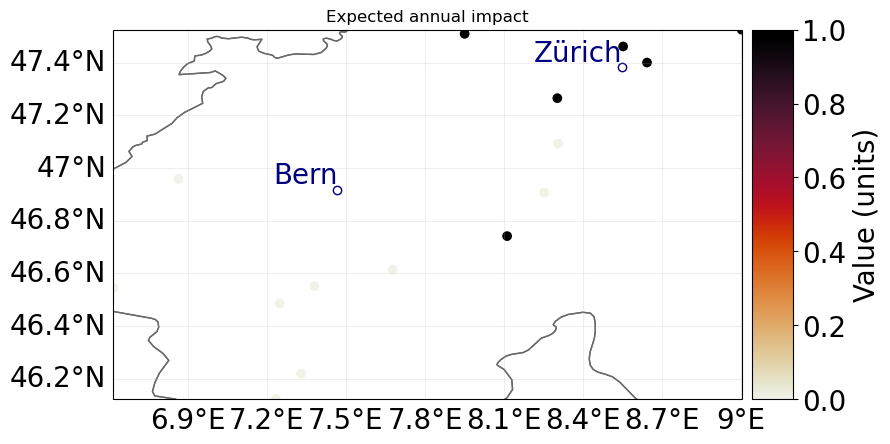

In [36]:
# Airports
imp_airport = ImpactCalc(exp_airports, impf_set, ws_lothar).impact()
imp_airport.plot_scatter_eai_exposure();

""" 
only for polygon-based exposure
# all-in-one calculation for lines: 
# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),
# and re-aggregate the sum of damages to the original exposure format

imp_airport = u_lp.calc_geom_impact(
    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM)

# plot the impacts
u_lp.plot_eai_exp_geom(imp_airport)
"""

In [58]:
# Railways

2023-08-23 12:02:48,647 - climada.util.lines_polys_handler - WARNING - 2085 lines with a length < 10*resolution were found. Each of these lines is disaggregate to one point. Reaggregatint values will thus likely lead to overestimattion. Consider chosing a smaller resolution or filter out the short lines. 
2023-08-23 12:02:51,653 - climada.entity.exposures.base - INFO - Setting latitude and longitude attributes.
2023-08-23 12:02:51,699 - climada.entity.exposures.base - INFO - Matching 137745 exposures with 3057 centroids.
2023-08-23 12:02:51,702 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-08-23 12:02:51,936 - climada.engine.impact_calc - INFO - Calculating impact for 413235 assets (>0) and 1 events.


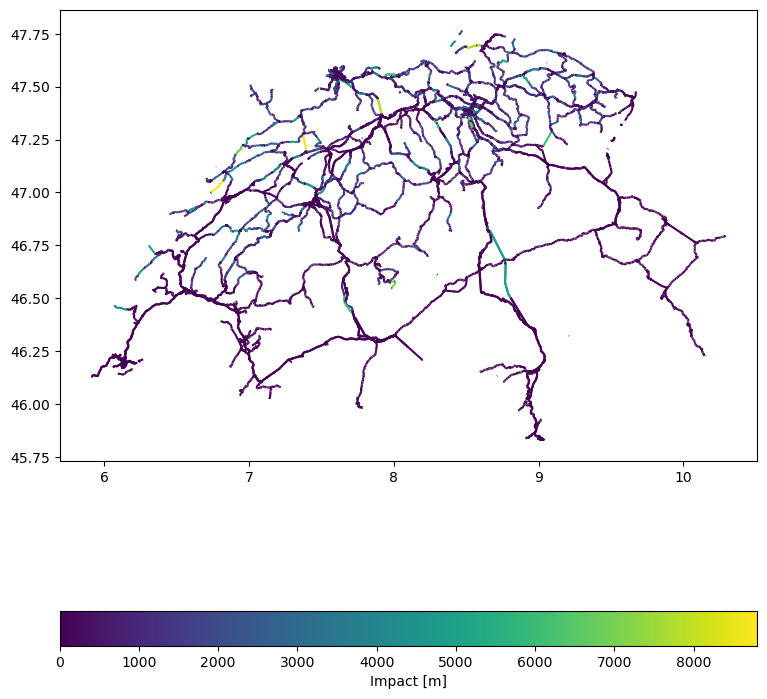

In [37]:
# railways

# all-in-one calculation for lines: 
# interpolate to 100 m resolution, assign each point a fixed value of 100 (metres),
# and re-aggregate the sum of damages to the original exposure format
imp_rails = u_lp.calc_geom_impact(
    exp=exp_rails, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100,
    agg_met=u_lp.AggMethod.SUM
)
imp_rails.unit = 'm'

# plot the impacts
u_lp.plot_eai_exp_geom(imp_rails);

In [38]:
# Some sanity checks & plots for methods figures
# disaggregated gdf length
gdf_rails_pnt = u_lp.gdf_to_pnts(gdf_rails, res=100, to_meters=True)
#(len(gdf_rails_pnt)*100)/12450052 #v1: 1.6278646868302238 #v2: 1.1063809211399278 #v3: 1.105717143974039

2023-08-23 12:02:55,329 - climada.util.lines_polys_handler - WARNING - 2085 lines with a length < 10*resolution were found. Each of these lines is disaggregate to one point. Reaggregatint values will thus likely lead to overestimattion. Consider chosing a smaller resolution or filter out the short lines. 


In [60]:
# checks original gdf length:
gdf_rails = gdf_rails.set_crs('EPSG:4326')
gdf_rails_proj = gdf_rails.to_crs('EPSG:2056')
gdf_rails_proj.geometry.length.sum()
# 12450052.771180911

12450052.771180911

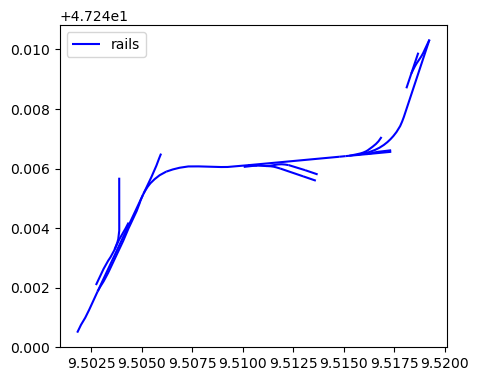

In [61]:
ax = gdf_rails.set_crs(epsg=4326).cx[ 9.4:9.7, 47.235:47.25].plot(figsize=(5, 5), alpha=1, markersize=20, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
plt.show()

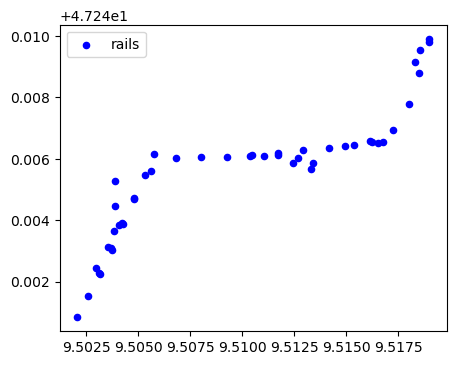

In [62]:
ax = gdf_rails_pnt.set_crs(epsg=4326).cx[9.4:9.7, 47.235:47.25].plot(figsize=(5, 5), alpha=1, markersize=20, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
plt.show()

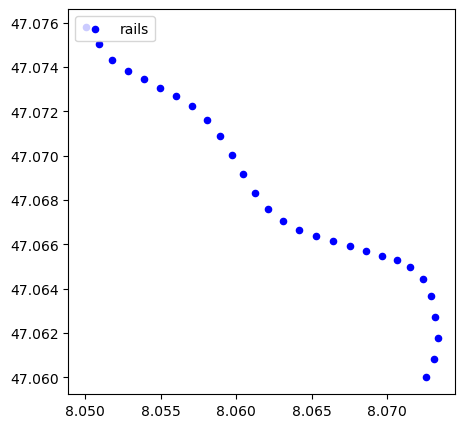

In [63]:
ax = gdf_rails_pnt.set_crs(epsg=4326).cx[ 8.05:8.09, 47.06:47.1].plot(figsize=(5, 5), alpha=1, markersize=20, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
plt.show()

In [65]:
impf_set.get_func()

{'WS': {1: <climada.entity.impact_funcs.storm_europe.ImpfStormEurope at 0x18a917d00>,
  2: <climada.entity.impact_funcs.base.ImpactFunc at 0x18cc16130>,
  4: <climada.entity.impact_funcs.base.ImpactFunc at 0x18cc16af0>}}

In [68]:
# Forest

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

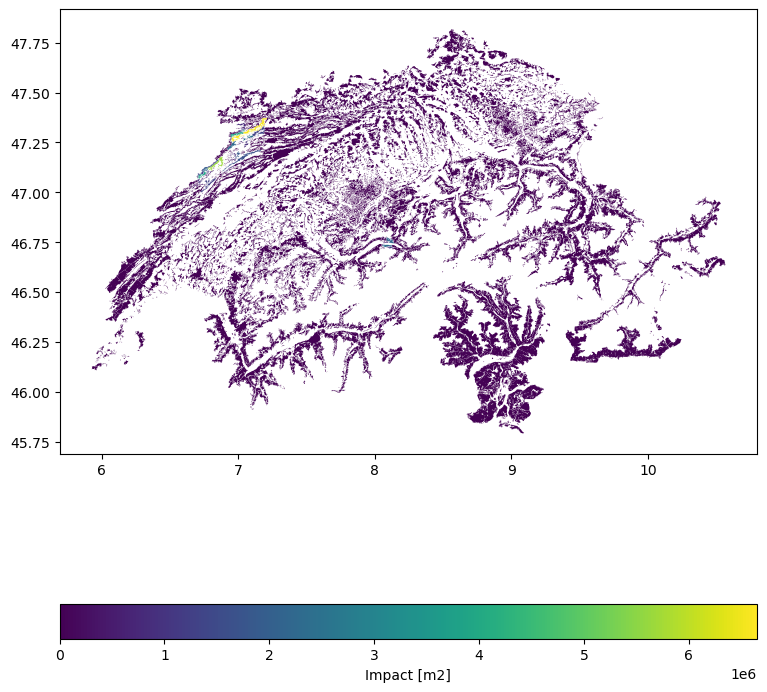

In [72]:
# Forest, with imp func 3 (>42); not used in the end.

imp_forest_42 = u_lp.calc_geom_impact(
    exp=exp_forest_42, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_42.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_42);

2023-06-26 11:16:17,534 - climada.entity.exposures.base - INFO - Setting latitude and longitude attributes.
2023-06-26 11:16:17,850 - climada.entity.exposures.base - INFO - Matching 1255598 exposures with 3057 centroids.
2023-06-26 11:16:17,859 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-06-26 11:16:19,719 - climada.engine.impact_calc - INFO - Calculating impact for 3766794 assets (>0) and 1 events.


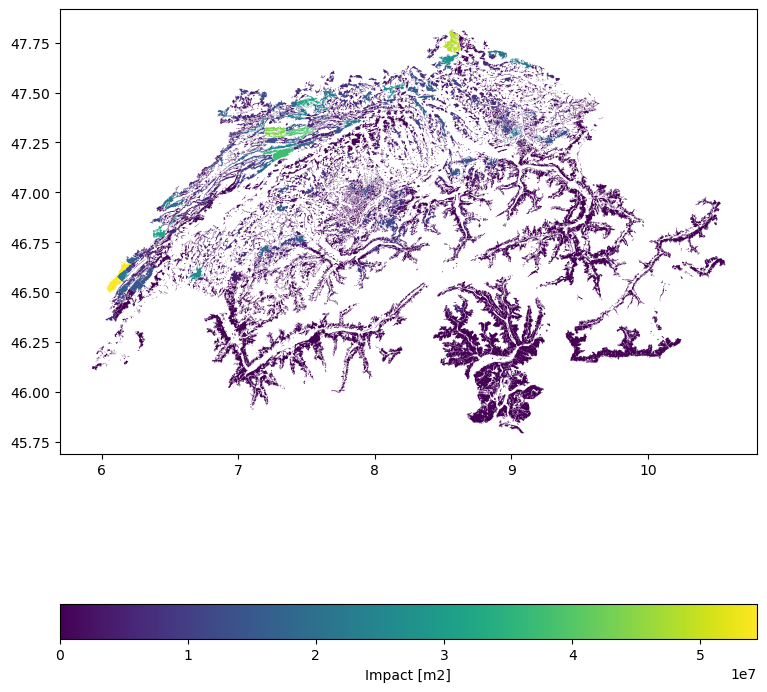

In [66]:
# Forest, with imp func 2 (>30.5)

imp_forest_W4 = u_lp.calc_geom_impact(
    exp=exp_forest_W4, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W4.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W4);

2023-08-23 12:04:24,744 - climada.entity.exposures.base - INFO - Setting latitude and longitude attributes.
2023-08-23 12:04:25,055 - climada.entity.exposures.base - INFO - Matching 1255598 exposures with 3057 centroids.
2023-08-23 12:04:25,064 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-08-23 12:04:27,011 - climada.engine.impact_calc - INFO - Calculating impact for 3766794 assets (>0) and 1 events.


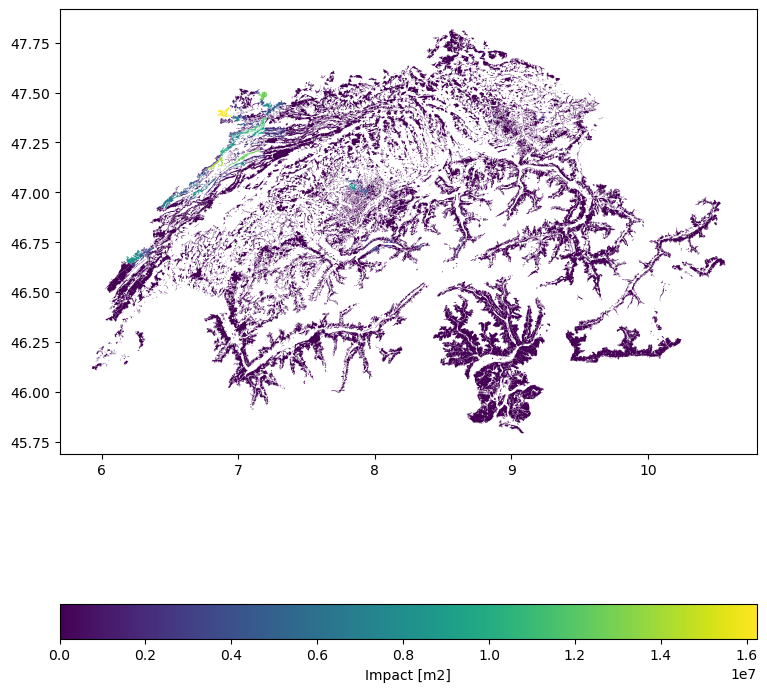

In [42]:
# Forest, with imp func 4 (>W5)

imp_forest_W5 = u_lp.calc_geom_impact(
    exp=exp_forest_W5, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W5.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W5);

2023-08-23 12:02:58,521 - climada.entity.exposures.base - INFO - Matching 11 exposures with 3057 centroids.
2023-08-23 12:02:58,524 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-08-23 12:02:58,530 - climada.engine.impact_calc - INFO - Calculating impact for 33 assets (>0) and 1 events.


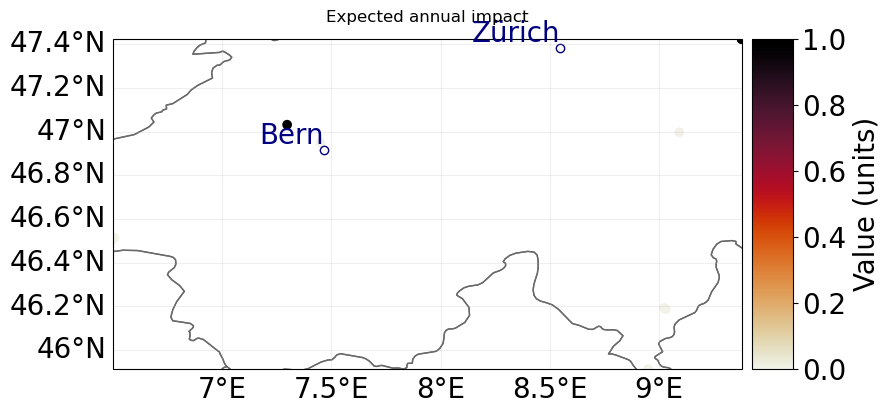

In [39]:
# Unesco heritage sites
imp_unesco = ImpactCalc(exp_unesco, impf_set, ws_lothar).impact()
imp_unesco.plot_scatter_eai_exposure();

2023-08-23 12:03:01,157 - climada.entity.exposures.base - INFO - Matching 70287 exposures with 3057 centroids.
2023-08-23 12:03:01,159 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-08-23 12:03:01,258 - climada.engine.impact_calc - INFO - Calculating impact for 204882 assets (>0) and 1 events.


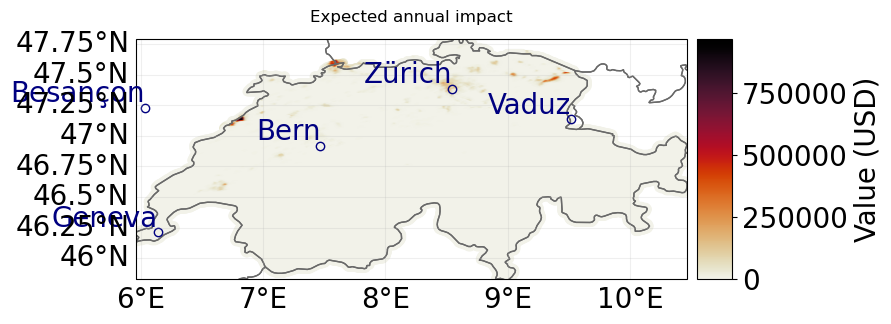

In [40]:
imp_lp = ImpactCalc(exp_lp, impf_set, ws_lothar).impact()
imp_lp.plot_scatter_eai_exposure();

2023-08-23 12:03:05,781 - climada.entity.exposures.base - INFO - Matching 70287 exposures with 3057 centroids.
2023-08-23 12:03:05,784 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-08-23 12:03:05,884 - climada.engine.impact_calc - INFO - Calculating impact for 204882 assets (>0) and 1 events.


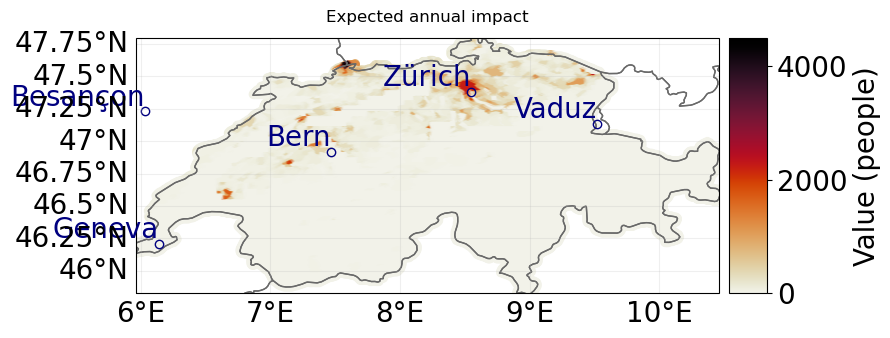

In [41]:
imp_pop = ImpactCalc(exp_pop, impf_set, ws_lothar).impact()
imp_pop.plot_scatter_eai_exposure();

**Impact overview plot**

In [43]:
imp_health_nz = imp_health.select(coord_exp = imp_health.coord_exp[np.bool8(imp_health.eai_exp)])
imp_airport_nz = imp_airport.select(coord_exp = imp_airport.coord_exp[np.bool8(imp_airport.eai_exp)])
imp_unesco_nz = imp_unesco.select(coord_exp = imp_unesco.coord_exp[np.bool8(imp_unesco.eai_exp)])
imp_pop_nz = imp_pop.select(coord_exp = imp_pop.coord_exp[imp_pop.eai_exp>500])
imp_lp_nz = imp_lp.select(coord_exp = imp_lp.coord_exp[imp_lp.eai_exp>5000])

2023-08-23 12:04:31,295 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 0
2023-08-23 12:04:31,298 - climada.engine.impact - INFO - The total value cannot be re-computed for a subset of exposures and is set to None.
2023-08-23 12:04:31,299 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 0
2023-08-23 12:04:31,300 - climada.engine.impact - INFO - The total value cannot be re-computed for a subset of exposures and is set to None.
2023-08-23 12:04:31,302 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 0
2023-08-23 12:04:31,303 - climada.engine.impact - INFO - The total value cannot be re-computed for a subset of exposures and is set to None.
2023-08-23 12:04:31,307 - climada.util.coordinates - INFO - No exact centroid m

In [44]:
imp_forest_nz_geom = imp_forest_W5.geom_exp[imp_forest_W5.eai_exp > 0]
imp_rails_nz_geom = imp_rails.geom_exp[imp_rails.eai_exp > 0]

In [91]:
#geometry = gpd.points_from_xy(imp_health_nz.coord_exp.T[1], imp_health_nz.coord_exp.T[0], crs=4326)
#gdf = gpd.GeoDataFrame({'value' : np.repeat('Healthcare facility', len(geometry))}, geometry=geometry)
geometry = gpd.points_from_xy(imp_airport_nz.coord_exp.T[1], imp_airport_nz.coord_exp.T[0], crs=4326)
gdf = gpd.GeoDataFrame({'value' : np.repeat('Airport', len(geometry))}, geometry=geometry)
geometry = gpd.points_from_xy(imp_unesco_nz.coord_exp.T[1], imp_unesco_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('UNESCO site', len(geometry))}, geometry=geometry)])
geometry = imp_forest_nz_geom.values
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Forest', len(geometry))}, geometry=geometry)])
geometry = imp_rails_nz_geom.values
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Railways', len(geometry))}, geometry=geometry)])
geometry = gpd.points_from_xy(imp_lp_nz.coord_exp.T[1], imp_lp_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Assets', len(geometry))}, geometry=geometry)])
geometry = gpd.points_from_xy(imp_pop_nz.coord_exp.T[1], imp_pop_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('People', len(geometry))}, geometry=geometry)])

In [92]:
#geometry = gpd.points_from_xy(imp_health_nz.coord_exp.T[1], imp_health_nz.coord_exp.T[0], crs=4326)
#gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Healthcare facility', len(geometry))}, geometry=geometry)])
geometry = imp_forest_nz_geom.values
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Forest', len(geometry))}, geometry=geometry)])

In [93]:
geometry = gpd.points_from_xy(imp_health_nz.coord_exp.T[1], imp_health_nz.coord_exp.T[0], crs=4326)
gdf_health = gpd.GeoDataFrame({'value' : np.repeat('Healthcare facility', len(geometry))}, geometry=geometry)

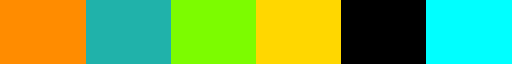

In [94]:
import matplotlib as mpl
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
cmap = ListedColormap(["darkorange", "lightseagreen", "lawngreen", "gold", "black", "cyan"])#"magenta", 
cmap

In [95]:
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

legend_elements = [Line2D([0], [0], color='black', lw=2, label='rails'),
                   Line2D([0], [0], marker="P", color='w', label='health. facility',
                          markerfacecolor='magenta', markersize=8),
                   Line2D([0], [0], marker='o', color='w', label='people',
                          markerfacecolor='gold', markersize=5),
                   Line2D([0], [0], marker='o', color='w', label='assets',
                          markerfacecolor='lightseagreen', markersize=5),
                   Line2D([0], [0], marker='o', color='w', label='airport',
                          markerfacecolor='darkorange', markersize=5),
                   Line2D([0], [0], marker='o', color='w', label='UNESCO site',
                          markerfacecolor='cyan', markersize=5),
                   Patch(facecolor='lawngreen', edgecolor='w',
                         label='forest')]

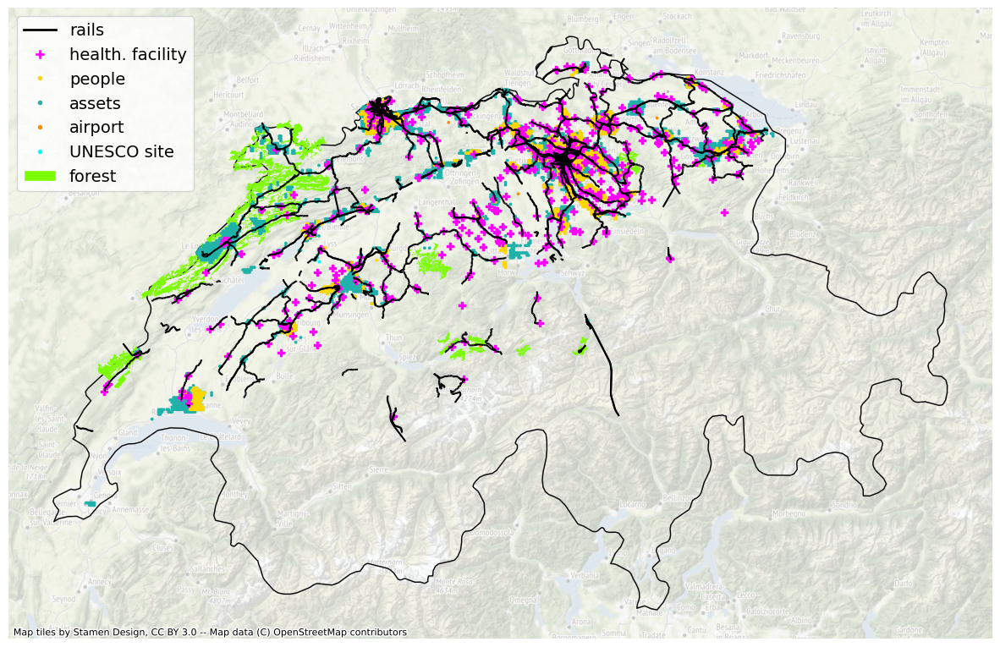

In [105]:
ax = gpd.GeoSeries(shp_che, crs='epsg:4326').to_crs(epsg=3857).plot(color=None, facecolor='none', edgecolor='k', linewidth=1,
                                                                   figsize=(15, 15),)
gdf.to_crs(epsg=3857).plot('value', categorical=True, legend=False, cmap = cmap, markersize=3, ax=ax)
gdf_health.to_crs(epsg=3857).plot(marker='P', color='magenta', legend=False, ax=ax)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=legend_elements, loc='upper left', fontsize=14)
ctx.add_basemap(ax, alpha=0.3)
plt.axis('off')
plt.savefig('lothar_impacts.png', dpi=300)
plt.show()


### Summary table Lothar

In [72]:
# Absolute impacts

In [92]:
summary_table_lothar = pd.DataFrame()
summary_table_lothar['exposure'] = ['Asset Values', 'Population', 'Healthcare Facilities', 'Airports','UNESCO world heritage sites',
                             'Railways', 'Forest Area (>W5)']
summary_table_lothar['impact'] = [imp.aai_agg for imp in [imp_lp, imp_pop, imp_health, imp_airport, imp_unesco,
                                                         imp_rails, imp_forest_W5]]
summary_table_lothar['metric'] = ['USD', 'people', 'units', 'units','units', 'm', 'm2']

In [150]:
summary_table_lothar

,exposure,impact,metric
0,Asset Values,1.794103e+08,USD
1,Population,4.175326e+06,people
2,Healthcare Facilities,6.490000e+02,units
3,Airports,6.000000e+00,units
4,UNESCO world heritage sites,3.000000e+00,units
5,Railways,1.022020e+07,m
6,Forest Area (>W5),4.646000e+08,m2


In [ ]:
# Relative Impacts

In [74]:
print(f'Rails: {imp_rails.aai_agg/(len(gdf_rails_pnt)*100)} \n heritage sites: {imp_unesco.aai_agg/len(gdf_unesco)} \n forest : {imp_forest_W5.aai_agg/12555980000} \n healthcare: {imp_health.aai_agg/len(gdf_health)} \n population: {imp_pop.aai_agg/exp_pop.gdf.value.sum()} \n asset values {imp_lp.aai_agg/exp_lp.gdf.value.sum()*100}')


Rails: 0.5045918182148172 
 heritage sites: 0.2727272727272727 
 forest : 0.037002288949170035 
 healthcare: 0.5619047619047619 
 population: 0.57596355218776 
 asset values 0.010479050501956763


### Verification Data Lothar

In [75]:
# building damage estimated: 600 million
imp_lp.aai_agg / 6e8

0.2990172301127822

In [98]:
# reported forest damage: 46000 ha (ca. 4.3% of total forest area)
# Damage value: 750 million 
area_forest_imp = 46000*10000
# total estimated forest area CH
area_forest_tot = area_forest_imp/0.043
# value per m2 of forest
val_per_m2_forest = 750*1e6/area_forest_imp

print('Areas OSM vs. Areas estimated CH', 12555980000/10000000000 )

print('Forest with 42m/s thresh: ', imp_forest_42.aai_agg/460000000)
print('Forest with > W4 thresh: ',imp_forest_W4.aai_agg/460000000)
print('Forest with > W5 thresh: ',imp_forest_W5.aai_agg/460000000)

Areas OSM vs. Areas estimated CH 1.255598
Forest with 42m/s thresh:  0.17547826086956522
Forest with > W4 thresh:  10.709108695652175
Forest with > W5 thresh:  1.01


In [99]:
"""
Durch umstürzende Bäume und Fahrleitungsrisse wurden zahlreiche Eisenbahnverbindungen in der 
gesamten Deutschschweiz unterbrochen. 
Die SBB hielten den Betrieb jedoch entsprechend den Umständen auf den nicht betroffenen Linien aufrecht. 
"""

'\nDurch umstürzende Bäume und Fahrleitungsrisse wurden zahlreiche Eisenbahnverbindungen in der \ngesamten Deutschschweiz unterbrochen. \nDie SBB hielten den Betrieb jedoch entsprechend den Umständen auf den nicht betroffenen Linien aufrecht. \n'

## 6. Probabilistic Winterstorms Risk calculations 

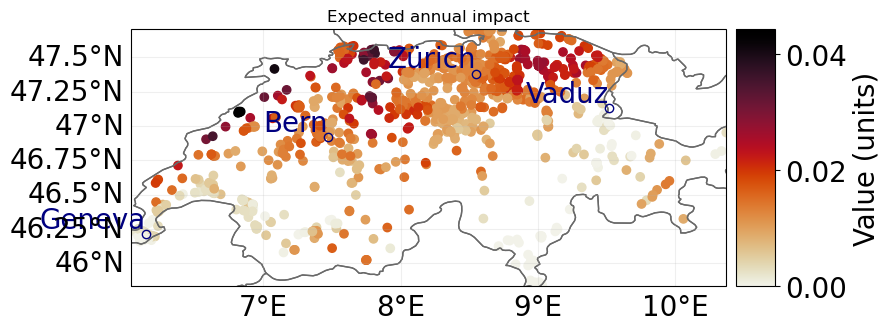

In [36]:
# Healthcare facilities
imp_health_ws = ImpactCalc(exp_health, impf_set, ws_che).impact()
imp_health_ws.plot_scatter_eai_exposure();

' \nonly for polygon-based exposure\n# all-in-one calculation for lines: \n# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),\n# and re-aggregate the sum of damages to the original exposure format\n\nimp_airport = u_lp.calc_geom_impact(\n    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,\n    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,\n    agg_met=u_lp.AggMethod.SUM)\n\n# plot the impacts\nu_lp.plot_eai_exp_geom(imp_airport)\n'

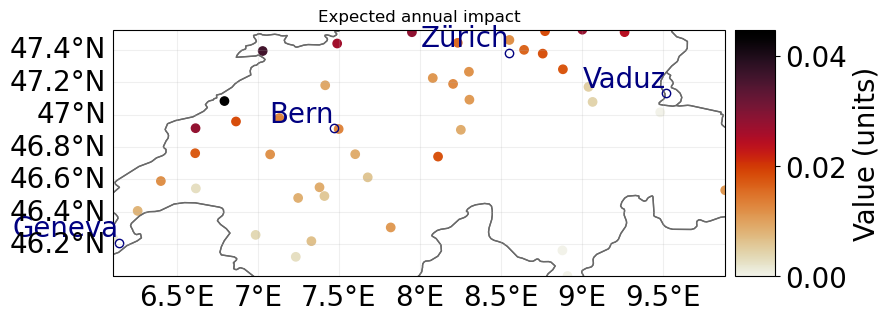

In [40]:
# Airports
imp_airport_ws = ImpactCalc(exp_airports, impf_set, ws_che).impact()
imp_airport_ws.plot_scatter_eai_exposure();

""" 
only for polygon-based exposure
# all-in-one calculation for lines: 
# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),
# and re-aggregate the sum of damages to the original exposure format

imp_airport = u_lp.calc_geom_impact(
    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM)

# plot the impacts
u_lp.plot_eai_exp_geom(imp_airport)
"""

In [41]:
exp_rails_pnt = u_lp.exp_geom_to_pnt(
    exp_rails, res=100, to_meters=True,
    disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100
)
imp_rails_pnt_ws = ImpactCalc(exp_rails_pnt, impf_set, ws_che).impact()

2023-08-29 11:24:27,286 - climada.util.lines_polys_handler - WARNING - 2085 lines with a length < 10*resolution were found. Each of these lines is disaggregate to one point. Reaggregatint values will thus likely lead to overestimattion. Consider chosing a smaller resolution or filter out the short lines. 


/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)


2023-06-26 11:22:36,674 - climada.util.lines_polys_handler - WARNING - 2085 lines with a length < 10*resolution were found. Each of these lines is disaggregate to one point. Reaggregatint values will thus likely lead to overestimattion. Consider chosing a smaller resolution or filter out the short lines. 
2023-06-26 11:22:39,812 - climada.entity.exposures.base - INFO - Setting latitude and longitude attributes.
2023-06-26 11:22:39,854 - climada.entity.exposures.base - INFO - Matching 137745 exposures with 3057 centroids.
2023-06-26 11:22:39,857 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-06-26 11:22:40,095 - climada.engine.impact_calc - INFO - Calculating impact for 413235 assets (>0) and 4260 events.


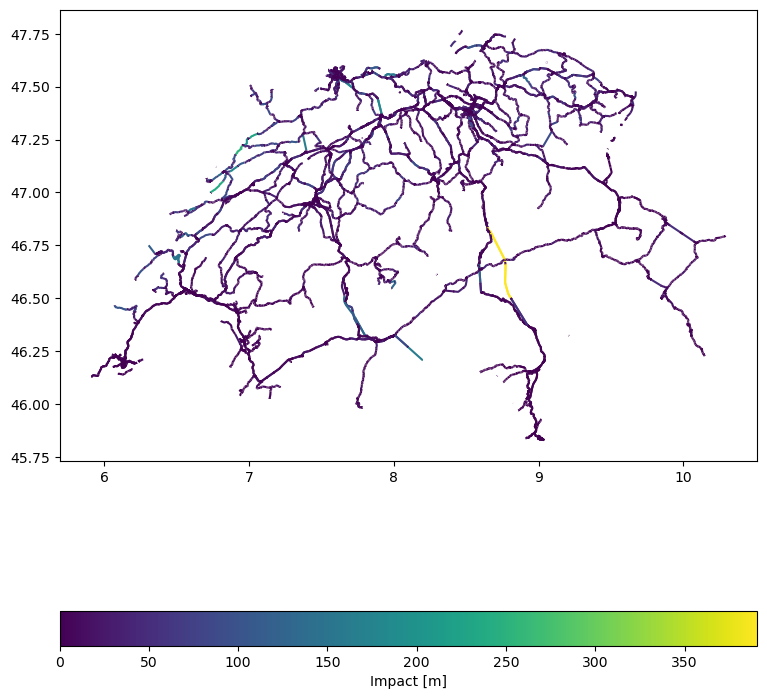

In [78]:
# railways

# all-in-one calculation for lines: 
# interpolate to 100 m resolution, assign each point a fixed value of 100 (metres),
# and re-aggregate the sum of damages to the original exposure format
imp_rails_ws = u_lp.calc_geom_impact(
    exp=exp_rails, impf_set=impf_set, haz=ws_che,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100,
    agg_met=u_lp.AggMethod.SUM
)
imp_rails_ws.unit = 'm'

# plot the impacts
u_lp.plot_eai_exp_geom(imp_rails_ws);

2023-06-26 11:27:25,358 - climada.entity.exposures.base - INFO - Setting latitude and longitude attributes.
2023-06-26 11:27:25,683 - climada.entity.exposures.base - INFO - Matching 1255598 exposures with 3057 centroids.
2023-06-26 11:27:25,692 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-06-26 11:27:27,665 - climada.engine.impact_calc - INFO - Calculating impact for 3766794 assets (>0) and 4260 events.


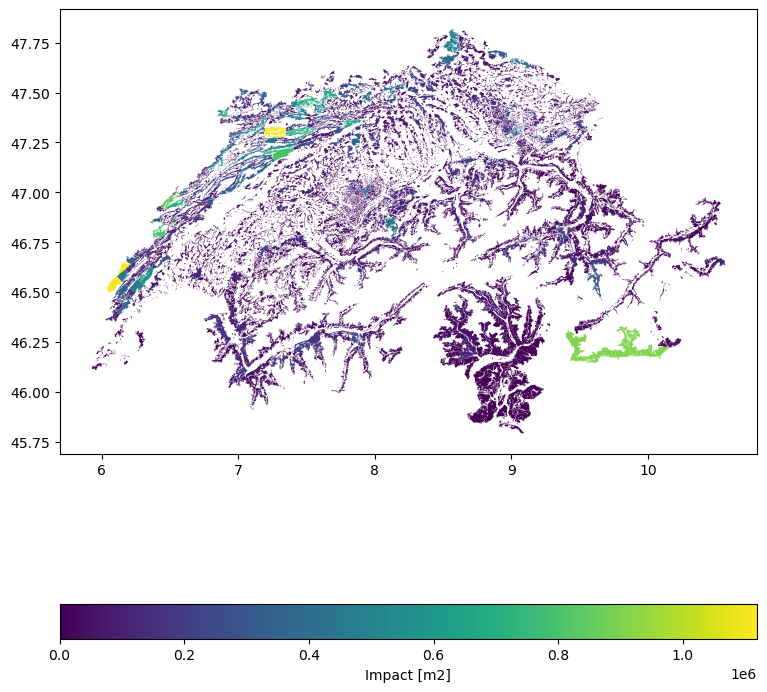

In [80]:
# Forest, with imp func 2 (>30.5)

imp_forest_W4_ws = u_lp.calc_geom_impact(
    exp=exp_forest_W4, impf_set=impf_set, haz=ws_che,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W4_ws.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W4_ws);

2023-06-26 11:33:20,352 - climada.entity.exposures.base - INFO - Setting latitude and longitude attributes.
2023-06-26 11:33:20,650 - climada.entity.exposures.base - INFO - Matching 1255598 exposures with 3057 centroids.
2023-06-26 11:33:20,659 - climada.util.coordinates - INFO - No exact centroid match found. Reprojecting coordinates to nearest neighbor closer than the threshold = 100
2023-06-26 11:33:22,538 - climada.engine.impact_calc - INFO - Calculating impact for 3766794 assets (>0) and 4260 events.


<Axes: >

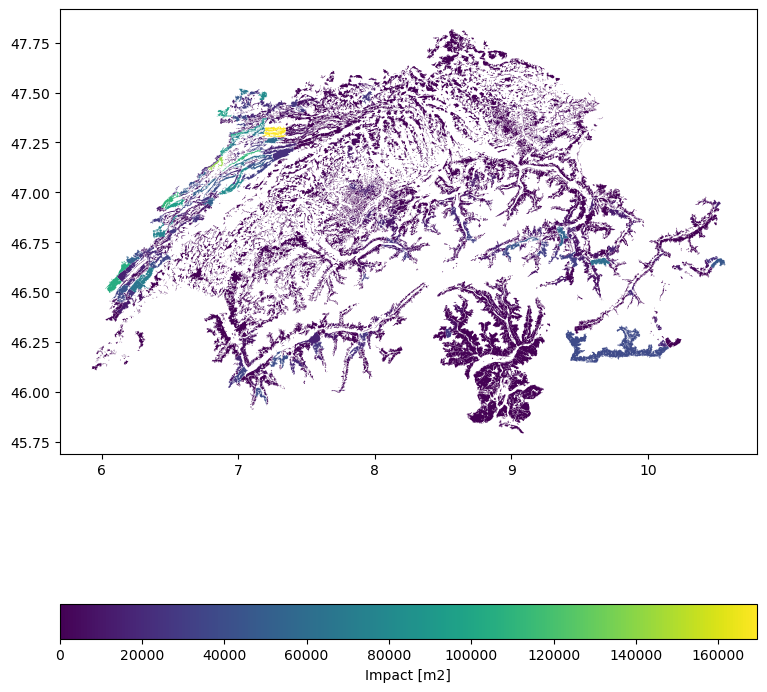

In [81]:
# Forest, withLitPopp func 4 (>W5)

imp_forest_W5_ws = u_lp.calc_geom_impact(
    exp=exp_forest_W5, impf_set=impf_set, haz=ws_che,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W5_ws.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W5_ws)

In [68]:
exp_forest_W5_pnt = u_lp.exp_geom_to_pnt(
    exp_forest_W5, res=100, to_meters=True,
    disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100
)
imp_forest_W5_pnt_ws = ImpactCalc(exp_forest_W5_pnt, impf_set, ws_che).impact()

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

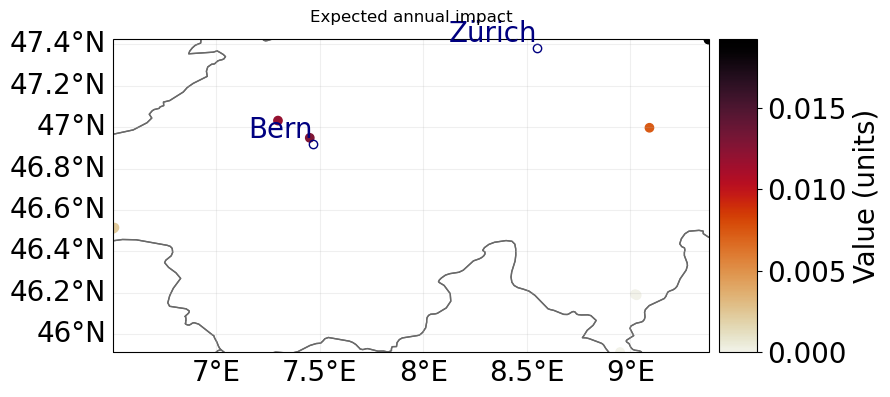

In [69]:
# Unesco heritage sites
imp_unesco_ws = ImpactCalc(exp_unesco, impf_set, ws_che).impact()
imp_unesco_ws.plot_scatter_eai_exposure();

In [70]:
exp_lp_2020 = LitPop().from_countries('CHE', reference_year=2020)

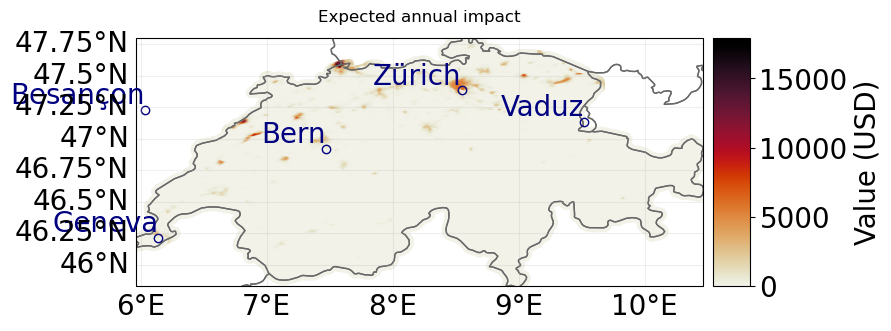

In [71]:
imp_lp_ws = ImpactCalc(exp_lp_2020, impf_set, ws_che).impact()
imp_lp_ws.plot_scatter_eai_exposure();

In [72]:
exp_pop_2020 = LitPop().from_countries('CHE', reference_year=2020, fin_mode='pop', exponents=(0, 1))

<GeoAxesSubplot:title={'center':'Expected annual impact'}>

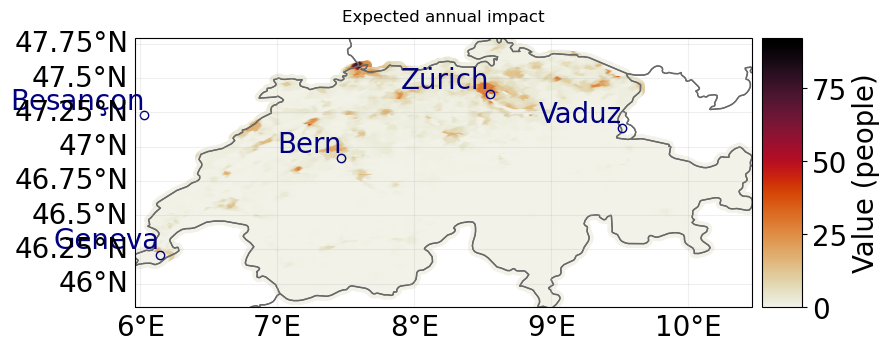

In [73]:
imp_pop_ws = ImpactCalc(exp_pop, impf_set, ws_che).impact()
imp_pop_ws.plot_scatter_eai_exposure()

Make plot of relative impact at each exposures location for all exposures type.

In [75]:
def make_gdf(impact):
    lat, lon = impact.coord_exp.T
    gdf = gpd.GeoDataFrame({
        'impact': impact.eai_exp,
        'impact_rel': impact.eai_exp / impact.eai_exp.max()
    }, geometry=gpd.points_from_xy(lon, lat), crs='epsg:4326')
    return gdf

In [76]:
names = ['Asset Values', 'Population', 'Healthcare Facilities', 'Airports','UNESCO world heritage sites',
                             'Railways', 'Forest Area (>W5)']
imps = [imp_lp_ws, imp_pop_ws, imp_health_ws, imp_airport_ws, imp_unesco_ws,
                                                         imp_rails_pnt_ws, imp_forest_W5_pnt_ws]
all_eai_pnt = {
    name : make_gdf(impact)
    for name, impact in zip(names, imps)
}

In [77]:
for name, gdf in all_eai_pnt.items():
    gdf.to_file(f'./data/eai_exp_pnt_{name}.shp')

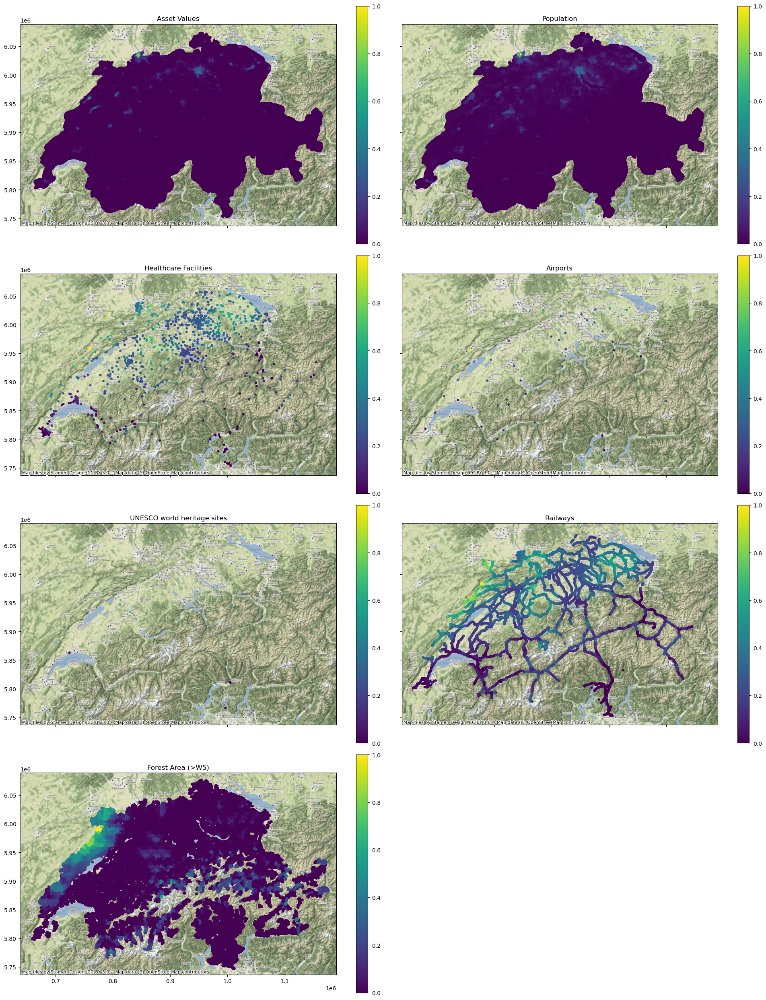

In [85]:
border = cfeature.NaturalEarthFeature('cultural', 'admin_0_countries', '50m')

fig, axes = plt.subplots(4,2, figsize=(20,25), sharex=True, sharey=True) 

for ax, exp_type in zip(axes.flatten(), names):
    ax = all_eai_pnt[exp_type].set_crs(epsg=4326).to_crs(epsg=3857).plot('impact_rel', legend=True, ax=ax, markersize=10)
    ax.set_title(exp_type);
    ctx.add_basemap(ax)

fig.delaxes(axes.flatten()[-1])
fig.tight_layout()
plt.savefig('./impacts_eai.png', 
                   format='png', dpi=150,
        bbox_inches=None, pad_inches=0.1,
        facecolor='auto', edgecolor='auto',
        backend=None)

### Summary table Risk WS

In [91]:
summary_table_ws = pd.DataFrame()
summary_table_ws['exposure'] = ['Asset Values', 'Population', 'Healthcare Facilities', 'Airports','UNESCO world heritage sites',
                             'Railways', 'Forest Area (>W5)']
summary_table_ws['average annual impact'] = [imp.aai_agg for imp in [imp_lp_ws, imp_pop_ws, imp_health_ws, imp_airport_ws, imp_unesco_ws,
                                                         imp_rails_ws, imp_forest_W5_ws]]
summary_table_ws['metric'] = ['USD', 'people', 'units', 'units','units', 'm', 'm2']

In [202]:
summary_table_ws

,exposure,average annual impact,metric
0,Asset Values,6.406225e+06,USD
1,Population,9.128907e+04,people
2,Healthcare Facilities,1.461416e+01,units
3,Airports,1.849315e-01,units
4,UNESCO world heritage sites,7.488584e-02,units
5,Railways,2.527149e+05,m
6,Forest Area (>W5),9.834516e+06,m2


In [88]:
# Relative Impacts
print(f'Rails: {imp_rails_ws.aai_agg/(len(gdf_rails_pnt)*100)} \n airports: {imp_airport_ws.aai_agg/len(gdf_airports)} \n heritage sites: {imp_unesco_ws.aai_agg/len(gdf_unesco)} \n forest : {imp_forest_W5_ws.aai_agg/12555980000} \n healthcare: {imp_health_ws.aai_agg/len(gdf_health)} \n population: {imp_pop_ws.aai_agg/exp_pop.gdf.value.sum()} \n asset values {imp_lp_ws.aai_agg/exp_lp.gdf.value.sum() * 100}')


Rails: 0.012544687912662387 
 airports: 0.012328767123287664 
 heritage sites: 0.006807804068078038 
 forest : 0.0007832535558144537 
 healthcare: 0.012652948269386618 
 population: 0.012592830594488246 
 asset values 0.0003741766400302681


### Return period curves WS 

In [89]:
return_per=np.arange(1,250)

In [93]:
values = summary_table_lothar['impact']
exp_type_list = summary_table_lothar['exposure']
lothar_impacts = {t : val for t, val in zip(exp_type_list, values)}
lothar_impacts

{'Asset Values': 179410338.06766933,
 'Population': 4175326.243275654,
 'Healthcare Facilities': 649.0,
 'Airports': 6.0,
 'UNESCO world heritage sites': 3.0,
 'Railways': 6950500.0,
 'Forest Area (>W5)': 464600000.0}

In [94]:
imp_lp_list = [imp_lp_ws, imp_pop_ws, imp_health_ws, imp_airport_ws, imp_unesco_ws, imp_rails_ws, imp_forest_W5_ws]
imp_lp_dict = {t: val for t, val in zip(exp_type_list, imp_lp_list)}

In [95]:
def find_rp(rp_curve, impact):
    rp_impacts = rp_curve.impact
    idx = (np.abs(rp_impacts - impact)).argmin()
    return rp_curve.return_per[idx]

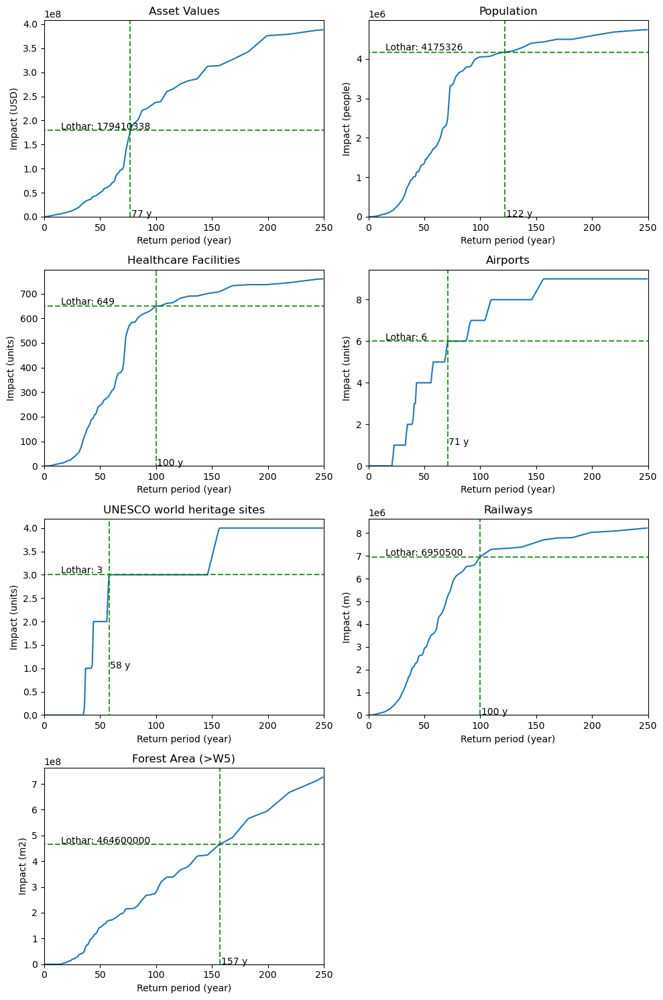

In [106]:
fig, axes = plt.subplots(figsize=(10, 15), ncols=2, nrows=4, sharex=False)
for ax, exp_type in zip(axes.flatten(), exp_type_list):
    rp_curve = imp_lp_dict[exp_type].calc_freq_curve(return_per=return_per)
    rp_curve.plot(axis=ax)
    rp_lothar = find_rp(rp_curve, lothar_impacts[exp_type])
    ax.set_title(exp_type);
    ax.hlines(lothar_impacts[exp_type], -10, 300, color='g', linestyle='--', alpha=0.8)
    ax.vlines(rp_lothar, -10, 2*max(rp_curve.impact), color='g', linestyle='--', alpha=0.8)
    ax.annotate(f'Lothar: {int(lothar_impacts[exp_type])}', xy=(25, 1.01*lothar_impacts[exp_type]),
                xytext=(15, 1.01*lothar_impacts[exp_type]))
    ax.annotate(f'{int(rp_lothar)} y', xy=(1.01*rp_lothar, 1),
                xytext=(1.01*rp_lothar, 1))
    ax.set_xlim([0, 250])
    ax.set_ylim(0, max(rp_curve.impact)*1.05)
fig.delaxes(axes.flatten()[-1])
fig.tight_layout()
plt.savefig('rp_curves.png', dpi=300)

In [107]:
rp_list = []
for exp_type in exp_type_list:
    rp_curve = imp_lp_dict[exp_type].calc_freq_curve(return_per=return_per)
    rp_lothar = find_rp(rp_curve, lothar_impacts[exp_type])
    rp_list.append(rp_lothar)

summary_table_rp_ws = pd.DataFrame()
summary_table_rp_ws['exposure'] = ['Asset Values', 'Population', 'Healthcare Facilities', 'Airports','UNESCO world heritage sites',
                             'Railways', 'Forest Area (>W5)']
summary_table_rp_ws['Return period'] = rp_list
summary_table_rp_ws['metric'] = ['Years', 'Years', 'Years', 'Years','Years', 'Years', 'Years']

In [108]:
summary_table_rp_ws

,exposure,Return period,metric
0,Asset Values,77,Years
1,Population,122,Years
2,Healthcare Facilities,100,Years
3,Airports,71,Years
4,UNESCO world heritage sites,58,Years
5,Railways,100,Years
6,Forest Area (>W5),157,Years


In [109]:
ws_che.size

4260

In [111]:
ws_che.orig.sum()

142

In [112]:
ws_che.size/ws_che.orig.sum()

30.0

In [ ]:
Start-date historic records: 1940-11-01 00:00:00
End-date historic records: 2013-12-05 00:00:00


In [114]:
(2013-1940)*30

2190